In [1228]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

Ficheros de temperatura

In [1229]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [1230]:
def delete(special_vals):
    return 1 if special_vals == 1 else 0

Cada dataframe de cada combinación tiene una columna que indica si el split es special value o no

In [1231]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle', 
            'blosclz-shuffle-split', 'blosclz-bitshuffle-split', 
            'zstd-shuffle-split', 'zstd-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes1 = {}
nsplits = [55296] * 6

for i in range(0, len(ficheros)):
    dataframes1[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes1[ficheros[i]]['codec_filter'] = codec_filter
    dataframes1[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    dataframes1[ficheros[i]]["delete"] = dataframes1[ficheros[i]].apply(lambda x: delete(x[2]), axis=1)

Ficheros de precipitaciones

In [1232]:
from pathlib import Path
path = Path('../data_inputs')

In [1233]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle', 
            'blosclz-shuffle-split', 'blosclz-bitshuffle-split', 
            'zstd-shuffle-split', 'zstd-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes2 = {}
nsplits = [55296] * 6

for i in range(0, len(ficheros)):
    dataframes2[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes2[ficheros[i]]['codec_filter'] = codec_filter
    dataframes2[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    dataframes2[ficheros[i]]["delete"] = dataframes2[ficheros[i]].apply(lambda x: delete(x[2]), axis=1)

Ficheros de viento

In [1234]:
from pathlib import Path
path = Path('../data_inputs_wind/')

In [1235]:
ficheros = ['entropy-shuffle', 'entropy-bitshuffle', 
            'blosclz-shuffle-split', 'blosclz-bitshuffle-split', 
            'zstd-shuffle-split', 'zstd-bitshuffle-split']

ficheros_path = [str(path) + '/' + fichero + '.csv.gz' for fichero in ficheros]
dataframes3 = {}
nsplits = [55296] * 6

for i in range(0, len(ficheros)):
    dataframes3[ficheros[i]] = pd.read_csv(ficheros_path[i], delimiter=',')
    codec_filter = np.repeat(ficheros[i], nsplits[i])
    dataframes3[ficheros[i]]['codec_filter'] = codec_filter
    dataframes3[ficheros[i]].rename(columns = {'cratio':'cratio', ' speed':'speed', ' special_vals':'special_vals', ' nchunk':'nchunk', ' category':'category'}, inplace = True)
    dataframes3[ficheros[i]]["delete"] = dataframes3[ficheros[i]].apply(lambda x: delete(x[2]), axis=1)

In [1236]:
#dataframes[ficheros[0]][dataframes[ficheros[0]]['special_vals'] == 0].head(n=15)

In [1237]:
#dataframes1[ficheros[0]]

In [1238]:
#dataframes[ficheros[1]][dataframes[ficheros[1]]['special_vals'] == 0].head(n=15)

In [1239]:
#dataframes.get(ficheros[5])

# NEURAL NETWORK (con las 4 categorías y los 3 datasets)

De las categorias entropy quiero su cratio y speed, no la función de puntuación a maximizar

In [1240]:
for i in range(0, 2):
    dataframes1[ficheros[i]] = dataframes1[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    dataframes1[ficheros[i]].rename(columns = {'delete':'delete' + str(i + 31)}, inplace = True)
    
    dataframes2[ficheros[i]] = dataframes2[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    dataframes2[ficheros[i]].rename(columns = {'delete':'delete' + str(i + 31)}, inplace = True)
    
    dataframes3[ficheros[i]] = dataframes3[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    dataframes3[ficheros[i]].rename(columns = {'delete':'delete' + str(i + 31)}, inplace = True)

In [1241]:
#dataframes3[ficheros[1]]

De las categorias NO entropy quiero su cratio, speed y delete.

In [1242]:
for i in range(2, len(ficheros)):
    dataframes1[ficheros[i]] = dataframes1[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    
    dataframes2[ficheros[i]] = dataframes2[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    
    dataframes3[ficheros[i]] = dataframes3[ficheros[i]].drop(['special_vals', 'nchunk', 'category', 'codec_filter'], axis = 1)
    
        
    dataframes1[ficheros[i]].rename(columns = {'delete':'delete' + str(i - 2)}, inplace = True)
    dataframes1[ficheros[i]].rename(columns = {'cratio':'cratio' + str(i - 2)}, inplace = True)
    dataframes1[ficheros[i]].rename(columns = {'speed':'speed' + str(i - 2)}, inplace = True)
    
    dataframes2[ficheros[i]].rename(columns = {'delete':'delete' + str(i - 2)}, inplace = True)
    dataframes2[ficheros[i]].rename(columns = {'cratio':'cratio' + str(i - 2)}, inplace = True)
    dataframes2[ficheros[i]].rename(columns = {'speed':'speed' + str(i - 2)}, inplace = True)
    
    dataframes3[ficheros[i]].rename(columns = {'delete':'delete' + str(i - 2)}, inplace = True)
    dataframes3[ficheros[i]].rename(columns = {'cratio':'cratio' + str(i - 2)}, inplace = True)
    dataframes3[ficheros[i]].rename(columns = {'speed':'speed' + str(i - 2)}, inplace = True)

In [1243]:
#dataframes1[ficheros[5]]

Procedimiento:

1. Juntar los datasets por filtro.

2. Filtrar los special values de cada filtro.

3. Calcular función a maximizar.

# NN SHUFFLE

# SHUFFLE - TEMP

Dataframe para nofilter

In [1244]:
#dataframes[ficheros[32]]

In [1245]:
dfSHUFFLE1 = pd.DataFrame()
for i in range(1, 3):
    dfSHUFFLE1 = pd.concat([dfSHUFFLE1, dataframes1[ficheros[2*i]]], axis = 1)
    
dfSHUFFLE1 = pd.concat([dfSHUFFLE1, dataframes1[ficheros[0]]], axis = 1)

In [1246]:
dfSHUFFLE1

,cratio0,speed0,delete0,cratio2,speed2,delete2,cratio,speed,delete31
0,16400.00,5.210000e+09,1,16400.0,5.520000e+09,1,16400.00,5.410000e+09,1
1,2.28,1.700000e+08,0,4.9,6.950000e+06,0,2.02,2.340000e+09,0
2,5.76,4.090000e+08,0,17.1,1.850000e+07,0,5.73,5.700000e+09,0
3,13100.00,5.210000e+09,1,13100.0,5.520000e+09,1,13100.00,5.410000e+09,1
4,16400.00,5.230000e+09,1,16400.0,5.540000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.170000e+09,1,16400.0,5.370000e+09,1,16400.00,5.390000e+09,1
55292,16400.00,5.240000e+09,1,16400.0,5.390000e+09,1,16400.00,5.390000e+09,1
55293,16400.00,5.120000e+09,1,16400.0,5.410000e+09,1,16400.00,5.420000e+09,1
55294,16400.00,5.280000e+09,1,16400.0,5.410000e+09,1,16400.00,5.370000e+09,1


# SHUFFLE - PRECIP

In [1247]:
dfSHUFFLE2 = pd.DataFrame()
for i in range(1, 3):
    dfSHUFFLE2 = pd.concat([dfSHUFFLE2, dataframes2[ficheros[2*i]]], axis = 1)
    
dfSHUFFLE2 = pd.concat([dfSHUFFLE2, dataframes2[ficheros[0]]], axis = 1)

In [1248]:
dfSHUFFLE2

,cratio0,speed0,delete0,cratio2,speed2,delete2,cratio,speed,delete31
0,16400.0,5.780000e+09,1,16400.0,7.220000e+09,1,16400.0,7.560000e+09,1
1,16400.0,6.960000e+09,1,16400.0,7.350000e+09,1,16400.0,7.670000e+09,1
2,29.3,1.280000e+09,0,85.4,3.680000e+07,0,39.7,1.510000e+10,0
3,35.3,1.950000e+09,0,106.0,4.130000e+07,0,36.5,1.970000e+10,0
4,16400.0,6.900000e+09,1,16400.0,7.050000e+09,1,16400.0,7.640000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.0,7.220000e+09,1,16400.0,7.080000e+09,1,16400.0,7.750000e+09,1
55292,16400.0,7.280000e+09,1,16400.0,7.050000e+09,1,16400.0,7.390000e+09,1
55293,16400.0,5.700000e+09,1,16400.0,6.120000e+09,1,16400.0,7.420000e+09,1
55294,16400.0,5.960000e+09,1,16400.0,7.750000e+09,1,16400.0,7.530000e+09,1


# SHUFFLE - WIND

In [1249]:
dfSHUFFLE3 = pd.DataFrame()
for i in range(1, 3):
    dfSHUFFLE3 = pd.concat([dfSHUFFLE3, dataframes3[ficheros[2*i]]], axis = 1)
    
dfSHUFFLE3 = pd.concat([dfSHUFFLE3, dataframes3[ficheros[0]]], axis = 1)

In [1250]:
dfSHUFFLE3

,cratio0,speed0,delete0,cratio2,speed2,delete2,cratio,speed,delete31
0,16400.0,5.520000e+09,1,16400.00,5.560000e+09,1,16400.00,5.540000e+09,1
1,5.8,3.860000e+08,0,20.20,1.440000e+07,0,6.56,6.450000e+09,0
2,1.9,1.520000e+08,0,3.15,8.210000e+06,0,1.50,2.520000e+09,0
3,32.1,1.720000e+09,0,91.00,4.470000e+07,0,15.60,1.200000e+10,0
4,16400.0,5.580000e+09,1,16400.00,5.440000e+09,1,16400.00,5.560000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.0,5.580000e+09,1,16400.00,5.580000e+09,1,16400.00,5.410000e+09,1
55292,16400.0,5.580000e+09,1,16400.00,5.460000e+09,1,16400.00,5.310000e+09,1
55293,16400.0,5.580000e+09,1,16400.00,5.440000e+09,1,16400.00,5.540000e+09,1
55294,16400.0,5.580000e+09,1,16400.00,5.460000e+09,1,16400.00,5.580000e+09,1


Si el chunk es special value en alguna de las combinaciones, se elimina.

# SHUFFLE - TODOS

In [1251]:
df_t_SHUFFLE = pd.DataFrame()
df_t_SHUFFLE = pd.concat([df_t_SHUFFLE, dfSHUFFLE1, dfSHUFFLE2, dfSHUFFLE3], axis = 0)
df_t_SHUFFLE

,cratio0,speed0,delete0,cratio2,speed2,delete2,cratio,speed,delete31
0,16400.00,5.210000e+09,1,16400.0,5.520000e+09,1,16400.00,5.410000e+09,1
1,2.28,1.700000e+08,0,4.9,6.950000e+06,0,2.02,2.340000e+09,0
2,5.76,4.090000e+08,0,17.1,1.850000e+07,0,5.73,5.700000e+09,0
3,13100.00,5.210000e+09,1,13100.0,5.520000e+09,1,13100.00,5.410000e+09,1
4,16400.00,5.230000e+09,1,16400.0,5.540000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.580000e+09,1,16400.0,5.580000e+09,1,16400.00,5.410000e+09,1
55292,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.310000e+09,1
55293,16400.00,5.580000e+09,1,16400.0,5.440000e+09,1,16400.00,5.540000e+09,1
55294,16400.00,5.580000e+09,1,16400.0,5.460000e+09,1,16400.00,5.580000e+09,1


In [1252]:
def delete_final(delete0, delete2, delete31):
    if (delete0 == 1 or delete2 == 1 or delete31 == 1):
        return 1
    else:
        return 0

In [1253]:
df_t_SHUFFLE["delete_f"] = df_t_SHUFFLE.apply(lambda x: delete_final(x[2], x[5], x[8]), axis=1)

In [1254]:
#df_t_SHUFFLE

Elimino los splits en los que alguna de las 3 combinaciones (shuffle y no entropy) sea un special_val

In [1255]:
df_t_SHUFFLE = df_t_SHUFFLE[df_t_SHUFFLE['delete_f'] == 0]

In [1256]:
#df_t_SHUFFLE

In [1257]:
df_t_SHUFFLE = df_t_SHUFFLE.drop(['delete0', 'delete2', 'delete31', 'delete_f'], axis = 1)

In [1258]:
df_t_SHUFFLE

,cratio0,speed0,cratio2,speed2,cratio,speed
1,2.28,1.700000e+08,4.90,6950000.0,2.02,2.340000e+09
2,5.76,4.090000e+08,17.10,18500000.0,5.73,5.700000e+09
5,2.29,1.760000e+08,4.95,7130000.0,2.11,2.700000e+09
6,5.81,4.310000e+08,18.20,19600000.0,6.10,6.340000e+09
9,2.35,1.840000e+08,5.17,7130000.0,2.23,2.710000e+09
...,...,...,...,...,...,...
55203,48.70,2.400000e+09,152.00,64000000.0,21.80,1.440000e+10
55206,6.33,4.540000e+08,13.30,25300000.0,3.70,4.770000e+09
55207,50.20,2.460000e+09,148.00,62000000.0,19.00,1.380000e+10
55210,14.30,9.870000e+08,29.90,61200000.0,3.99,5.190000e+09


Para calcular la mejor categoría, no tengo en cuenta los datos de la combinación de entropy-nofilter, por lo que los separo

In [1259]:
dfinput_shuffle_x = df_t_SHUFFLE.iloc[:, [4, 5]]

In [1260]:
df_t_SHUFFLE.shape

(77925, 6)

In [1261]:
dfinput_shuffle_x.shape

(77925, 2)

In [1262]:
df_t_SHUFFLE = df_t_SHUFFLE.drop(columns = ["cratio", "speed"])

In [1263]:
df_t_SHUFFLE.shape

(77925, 4)

In [1264]:
#df_t_SHUFFLE

In [1265]:
dfcratios = pd.DataFrame()
for i in range(0, 2):
    dfcratios = pd.concat([dfcratios, df_t_SHUFFLE.iloc[:, 2*i]], axis =0)

In [1266]:
desv_cratio = dfcratios.std()[0]
desv_cratio

240.0535926109704

In [1267]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

51.64828764837985

In [1268]:
dfspeeds = pd.DataFrame()
for i in range(0, 2):
    dfspeeds = pd.concat([dfspeeds, df_t_SHUFFLE.iloc[:, 2*i+1]], axis =0)

In [1269]:
mean_speed = dfspeeds.mean()[0]
mean_speed

589997909.4000641

In [1270]:
desv_speed = dfspeeds.std()[0]
desv_speed

1071727313.193207

Diccionario de dataframes sin special_values

In [1271]:
dataframes_filtered1 = {}

for i in range(1, 3):
    dataframes_filtered1[ficheros[2*i]] = df_t_SHUFFLE.iloc[:, [2*(i-1), 2*(i-1) + 1]]

In [1272]:
dataframes_filtered1[ficheros[4]]

,cratio2,speed2
1,4.90,6950000.0
2,17.10,18500000.0
5,4.95,7130000.0
6,18.20,19600000.0
9,5.17,7130000.0
...,...,...
55203,152.00,64000000.0
55206,13.30,25300000.0
55207,148.00,62000000.0
55210,29.90,61200000.0


Cálculo del SCORE

In [1273]:
theta = 0.95
for i in range (1, 3):
    cratio = dataframes_filtered1[ficheros[2*i]]['cratio'+ str((2*i)-2)]
    speed = dataframes_filtered1[ficheros[2*i]]['speed'+ str((2*i)-2)]
    
    #ncratio = (cratio - cratio.min()) / (cratio.max() - cratio.min())
    #nspeed = (speed - speed.min()) / (speed.max() - speed.min()) 
    
    ncratio = (cratio - mean_cratio) / desv_cratio
    nspeed = (speed - mean_speed) / desv_speed
    
    dataframes_filtered1[ficheros[2*i]].insert(2, str((2*i)-2), theta*ncratio + (1-theta)*nspeed)



In [1274]:
#dataframes_filtered1[ficheros[4]]

In [1275]:
df_t_SHUFFLE_filtered = pd.DataFrame()
for i in range(1, 3):
    df_t_SHUFFLE_filtered = pd.concat([df_t_SHUFFLE_filtered, dataframes_filtered1[ficheros[2*i]]], axis = 1)

In [1276]:
df_t_SHUFFLE_filtered

,cratio0,speed0,0,cratio2,speed2,2
1,2.28,1.700000e+08,-0.214967,4.90,6950000.0,-0.212205
2,5.76,4.090000e+08,-0.190045,17.10,18500000.0,-0.163386
5,2.29,1.760000e+08,-0.214647,4.95,7130000.0,-0.211999
6,5.81,4.310000e+08,-0.188821,18.20,19600000.0,-0.158981
9,2.35,1.840000e+08,-0.214037,5.17,7130000.0,-0.211128
...,...,...,...,...,...,...
55203,48.70,2.400000e+09,0.072776,152.00,64000000.0,0.372597
55206,6.33,4.540000e+08,-0.185690,13.30,25300000.0,-0.178107
55207,50.20,2.460000e+09,0.081511,148.00,62000000.0,0.356674
55210,14.30,9.870000e+08,-0.129282,29.90,61200000.0,-0.110738


In [1277]:
df_pos = df_t_SHUFFLE_filtered
for i in range(0, 2):
    df_pos = df_pos.drop(['cratio' + str(2*i), 'speed' + str(2*i)], axis = 1)

In [1278]:
df_pos

,0,2
1,-0.214967,-0.212205
2,-0.190045,-0.163386
5,-0.214647,-0.211999
6,-0.188821,-0.158981
9,-0.214037,-0.211128
...,...,...
55203,0.072776,0.372597
55206,-0.185690,-0.178107
55207,0.081511,0.356674
55210,-0.129282,-0.110738


In [1279]:
pos_min = df_pos.idxmax(axis=1)
pos_min = pd.DataFrame(pos_min, columns=['pos_min'])
#pos_min

In [1280]:
dfinput_shuffle_y = pos_min

In [1281]:
pos_min['pos_min'].unique()

array(['2', '0'], dtype=object)

In [1282]:
unique, counts = np.unique(pos_min, return_counts=True)
result = np.column_stack((unique, counts))
result

array([['0', 23601],
       ['2', 54324]], dtype=object)

Añadir las categorias que no superan cierto umbral en su score

In [1283]:
pos_min.iloc[0, :]

pos_min    2
Name: 1, dtype: object

In [1284]:
len(df_t_SHUFFLE_filtered)

77925

In [1285]:
def best_categories(inf, sup, dfinput_shuffle_x, dfinput_shuffle_y, df_t_SHUFFLE_filtered, df_pos):
    for i in range(inf, sup):
        best_pos_i = pos_min.iloc[i, :][0]
        #categoria 0 la mejor
        if best_pos_i == '0':
            #ambos scores negativos
            if df_pos.iloc[i, 1] < 0 and df_pos.iloc[i, 0] < 0:
                if df_pos.iloc[i, 1] >= 1.2 * df_pos.iloc[i, 0]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_SHUFFLE_filtered.iloc[i,3]]
                    new_speed = [df_t_SHUFFLE_filtered.iloc[i,4]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_shuffle_x = pd.concat([dfinput_shuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['2']
                    new_row['pos_min'] = new_pos
                    dfinput_shuffle_y = pd.concat([dfinput_shuffle_y, new_row], axis = 0)

            #algun score positivo
            elif df_pos.iloc[i, 1] >= 0 or df_pos.iloc[i, 0] >= 0:
                if df_pos.iloc[i, 1] >= 0.8 * df_pos.iloc[i, 0]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_SHUFFLE_filtered.iloc[i,3]]
                    new_speed = [df_t_SHUFFLE_filtered.iloc[i,4]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_shuffle_x = pd.concat([dfinput_shuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['2']
                    new_row['pos_min'] = new_pos
                    dfinput_shuffle_y = pd.concat([dfinput_shuffle_y, new_row], axis = 0)



        #categoria 2 la mejor
        else:
            #ambos scores negativos
            if df_pos.iloc[i, 0] < 0 and df_pos.iloc[i, 1] < 0:
                if df_pos.iloc[i, 0] >= 1.2 * df_pos.iloc[i, 1]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_SHUFFLE_filtered.iloc[i,0]]
                    new_speed = [df_t_SHUFFLE_filtered.iloc[i,1]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_shuffle_x = pd.concat([dfinput_shuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['0']
                    new_row['pos_min'] = new_pos
                    dfinput_shuffle_y = pd.concat([dfinput_shuffle_y, new_row], axis = 0)

            #algun score positivo
            elif df_pos.iloc[i, 0] >= 0 or df_pos.iloc[i, 1] >= 0:
                if df_pos.iloc[i, 0] >= 0.8 * df_pos.iloc[i, 1]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_SHUFFLE_filtered.iloc[i,0]]
                    new_speed = [df_t_SHUFFLE_filtered.iloc[i,1]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_shuffle_x = pd.concat([dfinput_shuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['0']
                    new_row['pos_min'] = new_pos
                    dfinput_shuffle_y = pd.concat([dfinput_shuffle_y, new_row], axis = 0)
                    
    #Resetear indices
    dfinput_shuffle_x = dfinput_shuffle_x.reset_index()
    dfinput_shuffle_x = dfinput_shuffle_x.drop(['index'], axis = 1)
    dfinput_shuffle_y = dfinput_shuffle_y.reset_index()
    dfinput_shuffle_y = dfinput_shuffle_y.drop(['index'], axis = 1)
    
    return dfinput_shuffle_x, dfinput_shuffle_y

In [1286]:
dfinput_shuffle_x.shape

(77925, 2)

In [1287]:
dfinput_shuffle_y.shape

(77925, 1)

In [1288]:
dfinput_shuffle_x, dfinput_shuffle_y = best_categories(0, len(df_t_SHUFFLE_filtered), dfinput_shuffle_x, dfinput_shuffle_y, df_t_SHUFFLE_filtered, df_pos)

In [1289]:
dfinput_shuffle_x.shape

(118899, 2)

In [1290]:
dfinput_shuffle_y.shape

(118899, 1)

In [1291]:
dfinput_shuffle_x

,cratio,speed
0,2.02,2.340000e+09
1,5.73,5.700000e+09
2,2.11,2.700000e+09
3,6.10,6.340000e+09
4,2.23,2.710000e+09
...,...,...
118894,4.20,1.330000e+07
118895,5.22,3.670000e+08
118896,5.97,4.400000e+08
118897,6.33,4.540000e+08


GRÀFICA

In [1292]:
df_fig_shuffle = pd.DataFrame()
df_fig_shuffle = pd.concat([df_fig_shuffle, dfinput_shuffle_x], axis = 1)
df_fig_shuffle = pd.concat([df_fig_shuffle, dfinput_shuffle_y], axis = 1)
df_fig_shuffle

,cratio,speed,pos_min
0,2.02,2.340000e+09,2
1,5.73,5.700000e+09,2
2,2.11,2.700000e+09,2
3,6.10,6.340000e+09,2
4,2.23,2.710000e+09,2
...,...,...,...
118894,4.20,1.330000e+07,2
118895,5.22,3.670000e+08,0
118896,5.97,4.400000e+08,0
118897,6.33,4.540000e+08,0


In [1293]:
fig_shuffle = px.scatter(df_fig_shuffle, "cratio", "speed", color = "pos_min")
fig_shuffle.show()

0: blosclz-shuffle-split (ràpid, poca compressió)


2: zstd-shuffle-split (lent, ràpida compressió)

In [1294]:
dfinput_shuffle_x

,cratio,speed
0,2.02,2.340000e+09
1,5.73,5.700000e+09
2,2.11,2.700000e+09
3,6.10,6.340000e+09
4,2.23,2.710000e+09
...,...,...
118894,4.20,1.330000e+07
118895,5.22,3.670000e+08
118896,5.97,4.400000e+08
118897,6.33,4.540000e+08


In [1295]:
dfinput_shuffle_y

,pos_min
0,2
1,2
2,2
3,2
4,2
...,...
118894,2
118895,0
118896,0
118897,0


# NN BITSHUFFLE

# BITSHUFFLE - TEMP

Dataframe para bitshuffle

In [1296]:
#dataframes[ficheros[32]]

In [1431]:
dfBITSHUFFLE1 = pd.DataFrame()
for i in range(1, 3):
    dfBITSHUFFLE1 = pd.concat([dfBITSHUFFLE1, dataframes1[ficheros[2*i+1]]], axis = 1)
    
dfBITSHUFFLE1 = pd.concat([dfBITSHUFFLE1, dataframes1[ficheros[1]]], axis = 1)

In [1432]:
dfBITSHUFFLE1

,cratio1,speed1,delete1,cratio3,speed3,delete3,cratio,speed,delete32
0,16400.00,5.540000e+09,1,16400.00,5.520000e+09,1,16400.00,5.390000e+09,1
1,1.00,1.930000e+09,0,3.37,1.050000e+07,0,156.00,8.070000e+09,0
2,5.67,3.830000e+08,0,13.90,1.770000e+07,0,1.89,2.420000e+09,0
3,226.00,3.810000e+09,0,1870.00,6.560000e+07,0,156.00,1.250000e+10,0
4,16400.00,5.390000e+09,1,16400.00,5.540000e+09,1,16400.00,5.370000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,16400.00,5.560000e+09,1,16400.00,5.560000e+09,1
55292,16400.00,5.580000e+09,1,16400.00,5.480000e+09,1,16400.00,5.560000e+09,1
55293,16400.00,5.600000e+09,1,16400.00,5.560000e+09,1,16400.00,5.580000e+09,1
55294,16400.00,5.560000e+09,1,16400.00,5.580000e+09,1,16400.00,5.580000e+09,1


# BITSHUFFLE - PRECIP

In [1433]:
dfBITSHUFFLE2 = pd.DataFrame()
for i in range(1, 3):
    dfBITSHUFFLE2 = pd.concat([dfBITSHUFFLE2, dataframes2[ficheros[2*i+1]]], axis = 1)
    
dfBITSHUFFLE2 = pd.concat([dfBITSHUFFLE2, dataframes2[ficheros[1]]], axis = 1)

In [1434]:
dfBITSHUFFLE2

,cratio1,speed1,delete1,cratio3,speed3,delete3,cratio,speed,delete32
0,16400.0,7.320000e+09,1,16400.0,7.380000e+09,1,16400.0,7.560000e+09,1
1,16400.0,7.670000e+09,1,16400.0,7.380000e+09,1,16400.0,7.830000e+09,1
2,36.3,1.100000e+09,0,95.3,4.080000e+07,0,156.0,7.980000e+09,0
3,42.1,1.570000e+09,0,125.0,6.010000e+07,0,18.7,1.180000e+10,0
4,16400.0,6.050000e+09,1,16400.0,7.790000e+09,1,16400.0,7.670000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.0,7.080000e+09,1,16400.0,7.560000e+09,1,16400.0,7.490000e+09,1
55292,16400.0,4.950000e+09,1,16400.0,7.530000e+09,1,16400.0,7.860000e+09,1
55293,16400.0,7.530000e+09,1,16400.0,5.660000e+09,1,16400.0,7.900000e+09,1
55294,16400.0,7.670000e+09,1,16400.0,6.140000e+09,1,16400.0,7.900000e+09,1


# BITSHUFFLE - WIND

In [1435]:
dfBITSHUFFLE3 = pd.DataFrame()
for i in range(1, 3):
    dfBITSHUFFLE3 = pd.concat([dfBITSHUFFLE3, dataframes3[ficheros[2*i+1]]], axis = 1)
    
dfBITSHUFFLE3 = pd.concat([dfBITSHUFFLE3, dataframes3[ficheros[1]]], axis = 1)

In [1436]:
dfBITSHUFFLE3

,cratio1,speed1,delete1,cratio3,speed3,delete3,cratio,speed,delete32
0,16400.00,5.560000e+09,1,16400.0,5.230000e+09,1,16400.00,5.480000e+09,1
1,19.20,1.480000e+09,0,26.3,3.510000e+07,0,156.00,5.520000e+09,0
2,1.64,1.820000e+08,0,2.4,6.790000e+06,0,1.08,3.170000e+09,0
3,30.70,1.590000e+09,0,73.7,4.150000e+07,0,7.19,7.080000e+09,0
4,16400.00,5.540000e+09,1,16400.0,5.580000e+09,1,16400.00,5.500000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,16400.0,5.580000e+09,1,16400.00,5.600000e+09,1
55292,16400.00,5.560000e+09,1,16400.0,5.560000e+09,1,16400.00,5.170000e+09,1
55293,16400.00,5.580000e+09,1,16400.0,5.560000e+09,1,16400.00,5.260000e+09,1
55294,16400.00,5.520000e+09,1,16400.0,5.560000e+09,1,16400.00,5.240000e+09,1


Si el chunk es special value en alguna de las combinaciones, se elimina.

# BITSHUFFLE - TODOS

In [1437]:
df_t_BITSHUFFLE = pd.DataFrame()
df_t_BITSHUFFLE = pd.concat([df_t_BITSHUFFLE, dfBITSHUFFLE1, dfBITSHUFFLE2, dfBITSHUFFLE3], axis = 0)
df_t_BITSHUFFLE

,cratio1,speed1,delete1,cratio3,speed3,delete3,cratio,speed,delete32
0,16400.00,5.540000e+09,1,16400.00,5.520000e+09,1,16400.00,5.390000e+09,1
1,1.00,1.930000e+09,0,3.37,1.050000e+07,0,156.00,8.070000e+09,0
2,5.67,3.830000e+08,0,13.90,1.770000e+07,0,1.89,2.420000e+09,0
3,226.00,3.810000e+09,0,1870.00,6.560000e+07,0,156.00,1.250000e+10,0
4,16400.00,5.390000e+09,1,16400.00,5.540000e+09,1,16400.00,5.370000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,16400.00,5.580000e+09,1,16400.00,5.600000e+09,1
55292,16400.00,5.560000e+09,1,16400.00,5.560000e+09,1,16400.00,5.170000e+09,1
55293,16400.00,5.580000e+09,1,16400.00,5.560000e+09,1,16400.00,5.260000e+09,1
55294,16400.00,5.520000e+09,1,16400.00,5.560000e+09,1,16400.00,5.240000e+09,1


In [1438]:
def delete_final(delete1, delete3, delete32):
    if (delete1 == 1 or delete3 == 1 or delete32 == 1):
        return 1
    else:
        return 0

In [1439]:
df_t_BITSHUFFLE["delete_f"] = df_t_BITSHUFFLE.apply(lambda x: delete_final(x[2], x[5], x[8]), axis=1)

In [1440]:
#df_t_BITSHUFFLE

Elimino los splits en los que alguna de las 3 combinaciones (bitshuffle y no entropy) sea un special_val

In [1441]:
df_t_BITSHUFFLE = df_t_BITSHUFFLE[df_t_BITSHUFFLE['delete_f'] == 0]

In [1442]:
#df_t_BITSHUFFLE

In [1443]:
df_t_BITSHUFFLE = df_t_BITSHUFFLE.drop(['delete1', 'delete3', 'delete32', 'delete_f'], axis = 1)

In [1444]:
df_t_BITSHUFFLE

,cratio1,speed1,cratio3,speed3,cratio,speed
1,1.00,1.930000e+09,3.37,10500000.0,156.00,8.070000e+09
2,5.67,3.830000e+08,13.90,17700000.0,1.89,2.420000e+09
3,226.00,3.810000e+09,1870.00,65600000.0,156.00,1.250000e+10
5,1.00,1.940000e+09,3.34,10800000.0,156.00,8.460000e+09
6,6.34,4.580000e+08,14.90,19400000.0,1.87,2.450000e+09
...,...,...,...,...,...,...
55203,60.50,2.710000e+09,156.00,56000000.0,13.00,1.060000e+10
55206,5.57,4.810000e+08,9.88,21200000.0,6.14,1.060000e+10
55207,61.10,2.760000e+09,153.00,55400000.0,13.50,1.170000e+10
55210,12.10,8.490000e+08,23.60,32100000.0,12.50,1.290000e+10


Para calcular la mejor categoría, no tengo en cuenta los datos de la combinación de entropy-bitshuffle, por lo que los separo

In [1445]:
dfinput_bitshuffle_x = df_t_BITSHUFFLE.iloc[:, [4, 5]]

In [1446]:
df_t_BITSHUFFLE.shape

(88584, 6)

In [1447]:
dfinput_bitshuffle_x.shape

(88584, 2)

In [1448]:
df_t_BITSHUFFLE = df_t_BITSHUFFLE.drop(columns = ["cratio", "speed"])

In [1449]:
df_t_BITSHUFFLE.shape

(88584, 4)

In [1450]:
#df_t_BITSHUFFLE

In [1451]:
dfcratios = pd.DataFrame()
for i in range(0, 2):
    dfcratios = pd.concat([dfcratios, df_t_BITSHUFFLE.iloc[:, 2*i]], axis =0)

In [1452]:
desv_cratio = dfcratios.std()[0]
desv_cratio

471.4937996126769

In [1453]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

168.2427863948343

In [1454]:
dfspeeds = pd.DataFrame()
for i in range(0, 2):
    dfspeeds = pd.concat([dfspeeds, df_t_BITSHUFFLE.iloc[:, 2*i+1]], axis =0)

In [1455]:
mean_speed = dfspeeds.mean()[0]
mean_speed

855722072.326831

In [1456]:
desv_speed = dfspeeds.std()[0]
desv_speed

1299922562.2774663

Diccionario de dataframes sin special_values

In [1457]:
dataframes_filtered2 = {}

for i in range(1, 3):
    dataframes_filtered2[ficheros[2*i+1]] = df_t_BITSHUFFLE.iloc[:, [2*(i-1), 2*(i-1) + 1]]

In [1458]:
dataframes_filtered2[ficheros[3]]

,cratio1,speed1
1,1.00,1.930000e+09
2,5.67,3.830000e+08
3,226.00,3.810000e+09
5,1.00,1.940000e+09
6,6.34,4.580000e+08
...,...,...
55203,60.50,2.710000e+09
55206,5.57,4.810000e+08
55207,61.10,2.760000e+09
55210,12.10,8.490000e+08


Cálculo del SCORE

In [1459]:
theta = 0.95
for i in range (1, 3):
    cratio = dataframes_filtered2[ficheros[2*i+1]]['cratio'+ str((2*i+1)-2)]
    speed = dataframes_filtered2[ficheros[2*i+1]]['speed'+ str((2*i+1)-2)]
    
    #ncratio = (cratio - cratio.min()) / (cratio.max() - cratio.min())
    #nspeed = (speed - speed.min()) / (speed.max() - speed.min()) 
    
    ncratio = (cratio - mean_cratio) / desv_cratio
    nspeed = (speed - mean_speed) / desv_speed
    
    dataframes_filtered2[ficheros[2*i+1]].insert(2, str((2*i+1)-2), theta*ncratio + (1-theta)*nspeed)



In [1460]:
#dataframes_filtered2[ficheros[5]]

In [1461]:
df_t_BITSHUFFLE_filtered = pd.DataFrame()
for i in range(1, 3):
    df_t_BITSHUFFLE_filtered = pd.concat([df_t_BITSHUFFLE_filtered, dataframes_filtered2[ficheros[2*i+1]]], axis = 1)

In [1462]:
df_t_BITSHUFFLE_filtered

,cratio1,speed1,1,cratio3,speed3,3
1,1.00,1.930000e+09,-0.295652,3.37,10500000.0,-0.364708
2,5.67,3.830000e+08,-0.345746,13.90,17700000.0,-0.343215
3,226.00,3.810000e+09,0.230006,1870.00,65600000.0,3.398433
5,1.00,1.940000e+09,-0.295267,3.34,10800000.0,-0.364757
6,6.34,4.580000e+08,-0.341511,14.90,19400000.0,-0.341134
...,...,...,...,...,...,...
55203,60.50,2.710000e+09,-0.145765,156.00,56000000.0,-0.055428
55206,5.57,4.810000e+08,-0.342178,9.88,21200000.0,-0.351180
55207,61.10,2.760000e+09,-0.142633,153.00,55400000.0,-0.061496
55210,12.10,8.490000e+08,-0.314866,23.60,32100000.0,-0.323116


In [1463]:
df_pos = df_t_BITSHUFFLE_filtered
for i in range(0, 2):
    df_pos = df_pos.drop(['cratio' + str(2*i+1), 'speed' + str(2*i+1)], axis = 1)

In [1464]:
df_pos

,1,3
1,-0.295652,-0.364708
2,-0.345746,-0.343215
3,0.230006,3.398433
5,-0.295267,-0.364757
6,-0.341511,-0.341134
...,...,...
55203,-0.145765,-0.055428
55206,-0.342178,-0.351180
55207,-0.142633,-0.061496
55210,-0.314866,-0.323116


In [1465]:
pos_min = df_pos.idxmax(axis=1)
pos_min = pd.DataFrame(pos_min, columns=['pos_min'])
#pos_min

In [1466]:
dfinput_bitshuffle_y = pos_min

In [1467]:
pos_min['pos_min'].unique()

array(['1', '3'], dtype=object)

In [1474]:
unique, counts = np.unique(pos_min, return_counts=True)
result = np.column_stack((unique, counts))
result

array([['1', 63249],
       ['3', 25335]], dtype=object)

Añadir las categorias que no superan cierto umbral en su score

In [1334]:
len(df_t_BITSHUFFLE_filtered)

88584

In [1468]:
def best_categories(inf, sup, dfinput_bitshuffle_x, dfinput_bitshuffle_y, df_t_BITSHUFFLE_filtered, df_pos):
    for i in range(inf, sup):
        best_pos_i = pos_min.iloc[i, :][0]
        #categoria 0 la mejor
        if best_pos_i == '1':
            #ambos scores negativos
            if df_pos.iloc[i, 1] < 0 and df_pos.iloc[i, 0] < 0:
                if df_pos.iloc[i, 1] >= 1.2 * df_pos.iloc[i, 0]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_BITSHUFFLE_filtered.iloc[i,3]]
                    new_speed = [df_t_BITSHUFFLE_filtered.iloc[i,4]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_bitshuffle_x = pd.concat([dfinput_bitshuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['3']
                    new_row['pos_min'] = new_pos
                    dfinput_bitshuffle_y = pd.concat([dfinput_bitshuffle_y, new_row], axis = 0)

            #algun score positivo
            elif df_pos.iloc[i, 1] >= 0 or df_pos.iloc[i, 0] >= 0:
                if df_pos.iloc[i, 1] >= 0.8 * df_pos.iloc[i, 0]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_BITSHUFFLE_filtered.iloc[i,3]]
                    new_speed = [df_t_BITSHUFFLE_filtered.iloc[i,4]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_bitshuffle_x = pd.concat([dfinput_bitshuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['3']
                    new_row['pos_min'] = new_pos
                    dfinput_bitshuffle_y = pd.concat([dfinput_bitshuffle_y, new_row], axis = 0)



        #categoria 2 la mejor
        else:
            #ambos scores negativos
            if df_pos.iloc[i, 0] < 0 and df_pos.iloc[i, 1] < 0:
                if df_pos.iloc[i, 0] >= 1.2 * df_pos.iloc[i, 1]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_BITSHUFFLE_filtered.iloc[i,0]]
                    new_speed = [df_t_BITSHUFFLE_filtered.iloc[i,1]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_bitshuffle_x = pd.concat([dfinput_bitshuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['1']
                    new_row['pos_min'] = new_pos
                    dfinput_bitshuffle_y = pd.concat([dfinput_bitshuffle_y, new_row], axis = 0)

            #algun score positivo
            elif df_pos.iloc[i, 0] >= 0 or df_pos.iloc[i, 1] >= 0:
                if df_pos.iloc[i, 0] >= 0.8 * df_pos.iloc[i, 1]:
                    #Actualizar input_x
                    new_row = pd.DataFrame()
                    new_cratio = [df_t_BITSHUFFLE_filtered.iloc[i,0]]
                    new_speed = [df_t_BITSHUFFLE_filtered.iloc[i,1]]
                    new_row['cratio'] = new_cratio
                    new_row['speed'] = new_speed
                    dfinput_bitshuffle_x = pd.concat([dfinput_bitshuffle_x, new_row], axis = 0)
                    
                    #Actualizar input_y
                    new_row = pd.DataFrame()
                    new_pos = ['1']
                    new_row['pos_min'] = new_pos
                    dfinput_bitshuffle_y = pd.concat([dfinput_bitshuffle_y, new_row], axis = 0)
                    
    #Resetear indices
    dfinput_bitshuffle_x = dfinput_bitshuffle_x.reset_index()
    dfinput_bitshuffle_x = dfinput_bitshuffle_x.drop(['index'], axis = 1)
    dfinput_bitshuffle_y = dfinput_bitshuffle_y.reset_index()
    dfinput_bitshuffle_y = dfinput_bitshuffle_y.drop(['index'], axis = 1)
    
    return dfinput_bitshuffle_x, dfinput_bitshuffle_y

In [1469]:
dfinput_bitshuffle_x.shape

(88584, 2)

In [1470]:
dfinput_bitshuffle_y.shape

(88584, 1)

In [1471]:
dfinput_bitshuffle_x, dfinput_bitshuffle_y = best_categories(0, len(df_t_BITSHUFFLE_filtered), dfinput_bitshuffle_x, dfinput_bitshuffle_y, df_t_BITSHUFFLE_filtered, df_pos)

In [1472]:
dfinput_bitshuffle_x.shape

(140191, 2)

In [1473]:
dfinput_bitshuffle_y.shape

(140191, 1)

GRÀFICA

In [1341]:
df_fig_bitshuffle = pd.DataFrame()
df_fig_bitshuffle = pd.concat([df_fig_bitshuffle, dfinput_bitshuffle_x], axis = 1)
df_fig_bitshuffle = pd.concat([df_fig_bitshuffle, dfinput_bitshuffle_y], axis = 1)
df_fig_bitshuffle

,cratio,speed,pos_min
0,156.00,8.070000e+09,1
1,1.89,2.420000e+09,3
2,156.00,1.250000e+10,3
3,156.00,8.460000e+09,1
4,1.87,2.450000e+09,3
...,...,...,...
140186,8.78,2.430000e+07,3
140187,37.00,3.950000e+07,3
140188,8.81,2.020000e+07,3
140189,9.88,2.120000e+07,3


In [1342]:
fig_bitshuffle = px.scatter(df_fig_bitshuffle, "cratio", "speed", color = "pos_min")
fig_bitshuffle.show()

# Balanceo cuando he juntado todas las categorias

In [1343]:
dfinput_total_x = pd.DataFrame()
dfinput_total_x = pd.concat([dfinput_total_x ,dfinput_shuffle_x], axis = 0)
dfinput_total_x = pd.concat([dfinput_total_x ,dfinput_bitshuffle_x], axis = 0)

dfinput_total_y = pd.DataFrame()
dfinput_total_y = pd.concat([dfinput_total_y ,dfinput_shuffle_y], axis = 0)
dfinput_total_y = pd.concat([dfinput_total_y ,dfinput_bitshuffle_y], axis = 0)

dfinput_total = pd.DataFrame()
dfinput_total = pd.concat([dfinput_total ,dfinput_total_x], axis = 1)
dfinput_total = pd.concat([dfinput_total ,dfinput_total_y], axis = 1)

In [1344]:
dfinput_total['pos_min'].unique()

array(['2', '0', '1', '3'], dtype=object)

In [1345]:
dfinput_total_x = dfinput_total.iloc[:, [0,1]]

In [1346]:
dfinput_total_y = pd.DataFrame()
dfinput_total_y = pd.concat([dfinput_total_y, dfinput_total['pos_min']], axis = 1)

GRÀFICA

In [1347]:
df_fig_total = pd.DataFrame()
df_fig_total = pd.concat([df_fig_total, dfinput_total_x], axis = 1)
df_fig_total = pd.concat([df_fig_total, dfinput_total_y], axis = 1)
df_fig_total

,cratio,speed,pos_min
0,2.02,2.340000e+09,2
1,5.73,5.700000e+09,2
2,2.11,2.700000e+09,2
3,6.10,6.340000e+09,2
4,2.23,2.710000e+09,2
...,...,...,...
140186,8.78,2.430000e+07,3
140187,37.00,3.950000e+07,3
140188,8.81,2.020000e+07,3
140189,9.88,2.120000e+07,3


In [1348]:
fig_total = px.scatter(df_fig_total, "cratio", "speed", color = "pos_min")
fig_total.show()

0: blosclz-shuffle-split

1: blosclz-bitshuffle-split

2: zstd-shuffle-split

3: zstd-bitshuffle-split

BALANCEAR

In [1349]:
categorias = dfinput_total_y['pos_min'].unique()
categorias

array(['2', '0', '1', '3'], dtype=object)

In [1350]:
unique, counts = np.unique(dfinput_total_y, return_counts=True)
result = np.column_stack((unique, counts))
result

array([['0', 56568],
       ['1', 70969],
       ['2', 62331],
       ['3', 69222]], dtype=object)

In [1351]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, dfinput_total_x['cratio']], axis = 1)
df_t = pd.concat([df_t, dfinput_total_x['speed']], axis = 1)
df_t = pd.concat([df_t, dfinput_total_y['pos_min']], axis = 1)
df_t

,cratio,speed,pos_min
0,2.02,2.340000e+09,2
1,5.73,5.700000e+09,2
2,2.11,2.700000e+09,2
3,6.10,6.340000e+09,2
4,2.23,2.710000e+09,2
...,...,...,...
140186,8.78,2.430000e+07,3
140187,37.00,3.950000e+07,3
140188,8.81,2.020000e+07,3
140189,9.88,2.120000e+07,3


In [1352]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['pos_min'] == i]
    df_i = df_i.head(n=56568)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio,speed,pos_min
0,2.02,2.340000e+09,2
1,5.73,5.700000e+09,2
2,2.11,2.700000e+09,2
3,6.10,6.340000e+09,2
4,2.23,2.710000e+09,2
...,...,...,...
126426,3.01,1.150000e+07,3
126427,2.74,1.110000e+07,3
126428,4.10,1.170000e+07,3
126429,3.54,1.150000e+07,3


In [1353]:
dfinput_total_y = pd.DataFrame()
dfinput_total_y = pd.concat([dfinput_total_y, df_blc['pos_min']], axis = 1)

In [1354]:
dfinput_total_x = df_blc.drop(['pos_min'], axis = 1)

In [1355]:
dfinput_total_x.shape

(226272, 2)

In [1356]:
dfinput_total_y.shape

(226272, 1)

# DIVISIÓN AUTOMÁTICA

In [1357]:
from keras.utils import to_categorical
dfinput_total_y = to_categorical(dfinput_total_y)

In [1420]:
from keras import models, layers
from keras.initializers import GlorotUniform

from numpy.random import seed
seed(1)
import tensorflow
tensorflow.random.set_seed(1)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(1,2)))
model.add(layers.Dense(10, activation='relu'))
model.add(layers.Dense(4, activation='softmax'))

In [1421]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [1422]:
history = model.fit(dfinput_total_x, dfinput_total_y, epochs=30, validation_split=0.1)

Epoch 1/30
6364/6364 [==============================] - 3s 416us/step - loss: 27169252.3968 - acc: 0.2557 - val_loss: 4.1365 - val_acc: 0.0000e+00
Epoch 2/30
6364/6364 [==============================] - 3s 439us/step - loss: 52.9975 - acc: 0.4203 - val_loss: 2.0184 - val_acc: 0.0000e+00
Epoch 3/30
6364/6364 [==============================] - 3s 459us/step - loss: 1.3912 - acc: 0.2780 - val_loss: 1.7871 - val_acc: 0.0000e+00
Epoch 4/30
6364/6364 [==============================] - 3s 418us/step - loss: 1.3669 - acc: 0.2761 - val_loss: 1.8016 - val_acc: 0.0000e+00
Epoch 5/30
6364/6364 [==============================] - 3s 418us/step - loss: 1.3662 - acc: 0.2782 - val_loss: 1.8139 - val_acc: 0.0000e+00
Epoch 6/30
6364/6364 [==============================] - 2s 389us/step - loss: 1.3663 - acc: 0.2755 - val_loss: 1.7775 - val_acc: 0.0000e+00
Epoch 7/30
6364/6364 [==============================] - 3s 394us/step - loss: 1.3662 - acc: 0.2777 - val_loss: 1.8068 - val_acc: 0.0000e+00
Epoch 8/30
6

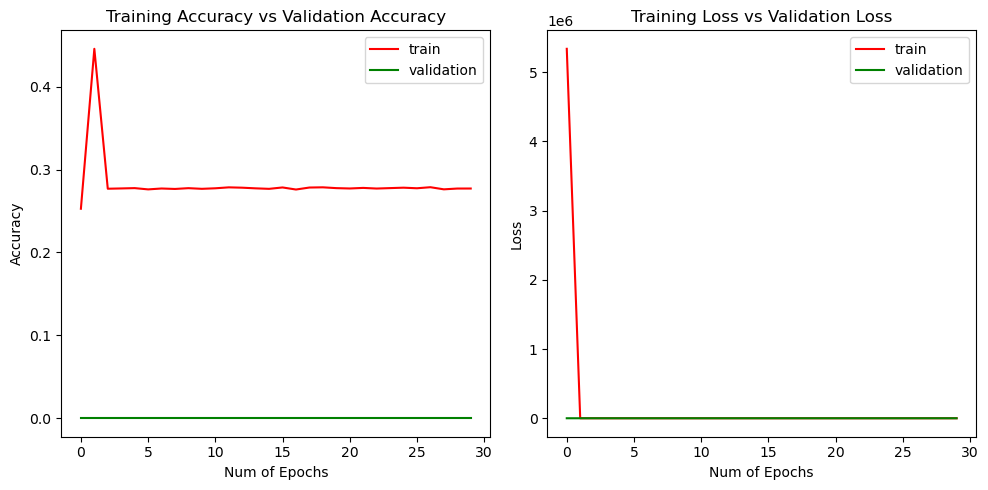

In [1423]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

Vector con las probabilidades predecidas por la red de cada categoría en cada chunk

In [1424]:
y_hat = model.predict(x=dfinput_total_x)
y_hat

array([[0.27615532, 0.27784592, 0.277171  , 0.16882776],
       [0.27615532, 0.27784592, 0.277171  , 0.16882776],
       [0.27615532, 0.27784592, 0.277171  , 0.16882776],
       ...,
       [0.27615532, 0.27784592, 0.277171  , 0.16882776],
       [0.27615532, 0.27784592, 0.277171  , 0.16882776],
       [0.27615532, 0.27784592, 0.277171  , 0.16882776]], dtype=float32)

In [1425]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_total_y, axis = 1)

Vector de predicciones

In [1426]:
y_pred_label

array([1, 1, 1, ..., 1, 1, 1])

Categorías que se han predicho.
(En este caso se repite siempre la misma, la número 9)

In [1427]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[     1, 226272]])

Vector de resultados reales

In [1428]:
y_true_label

array([2, 2, 2, ..., 3, 3, 3])

Mejores categorías reales y en cuantos splits lo son.

In [1429]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 56568],
       [    1, 56568],
       [    2, 56568],
       [    3, 56568]])

In [1430]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla

col_0,0,1,2,3
row_0,,,,
1,56568,56568,56568,56568


# DIVIDIR MANUALMENTE TRAIN Y TEST

In [1047]:
from sklearn.model_selection import train_test_split

# Split the data
x_train, x_test, y_train, y_test = train_test_split(dfinput_total_x, dfinput_total_y, test_size=0.2, shuffle= True)

In [1048]:
x_train.shape

(103472, 2)

In [1049]:
y_train.shape

(103472, 1)

In [1050]:
x_test.shape

(25868, 2)

In [1051]:
y_test.shape

(25868, 1)

In [1052]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts))
result

array([['0', 25887],
       ['1', 25886],
       ['2', 25776],
       ['3', 25923]], dtype=object)

In [1053]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts))
result

array([['0', 6448],
       ['1', 6449],
       ['2', 6559],
       ['3', 6412]], dtype=object)

In [1054]:
from keras.utils import to_categorical
y_train = to_categorical(y_train)

In [1055]:
y_test = to_categorical(y_test)

In [1056]:
from keras import models, layers
from keras.utils import 
model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(1,2)))
model.add(layers.Dense(5, activation='relu'))
model.add(layers.Dense(4, activation='softmax'))

In [1057]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [1058]:
history = model.fit(x_train, y_train, epochs = 50, validation_data = (x_test, y_test))

Epoch 1/50
3234/3234 [==============================] - 2s 473us/step - loss: 484373073.3799 - acc: 0.2510 - val_loss: 1.3889 - val_acc: 0.2536
Epoch 2/50
3234/3234 [==============================] - 1s 431us/step - loss: 1.3870 - acc: 0.2519 - val_loss: 1.3863 - val_acc: 0.2493
Epoch 3/50
3234/3234 [==============================] - 1s 425us/step - loss: 1.3864 - acc: 0.2515 - val_loss: 1.3863 - val_acc: 0.2536
Epoch 4/50
3234/3234 [==============================] - 1s 432us/step - loss: 1.3864 - acc: 0.2495 - val_loss: 1.3863 - val_acc: 0.2536
Epoch 5/50
3234/3234 [==============================] - 1s 424us/step - loss: 1.3864 - acc: 0.2490 - val_loss: 1.3864 - val_acc: 0.2479
Epoch 6/50
3234/3234 [==============================] - 1s 425us/step - loss: 1.3864 - acc: 0.2512 - val_loss: 1.3865 - val_acc: 0.2479
Epoch 7/50
3234/3234 [==============================] - 1s 426us/step - loss: 1.3864 - acc: 0.2496 - val_loss: 1.3865 - val_acc: 0.2479
Epoch 8/50
3234/3234 [==================

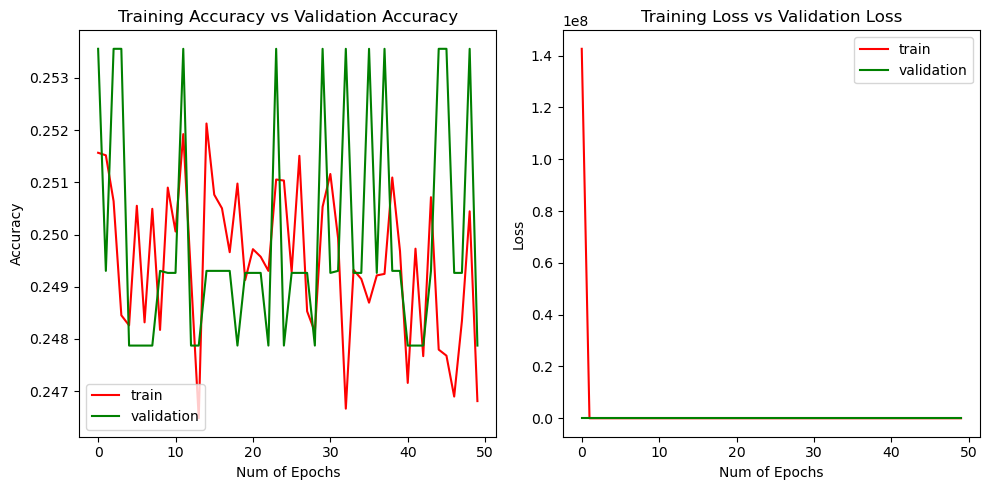

In [1059]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [1060]:
y_hat = model.predict(x=x_test)
y_hat

array([[0.24779451, 0.24956064, 0.25117356, 0.25147125],
       [0.24779451, 0.24956064, 0.25117356, 0.25147125],
       [0.24779451, 0.24956064, 0.25117356, 0.25147125],
       ...,
       [0.24779451, 0.24956064, 0.25117356, 0.25147125],
       [0.24779451, 0.24956064, 0.25117356, 0.25147125],
       [0.24779451, 0.24956064, 0.25117356, 0.25147125]], dtype=float32)

In [1061]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(y_test, axis = 1)

Vector de predicciones

In [1062]:
y_pred_label

array([3, 3, 3, ..., 3, 3, 3])

Categorías que se han predicho.
(En este caso se repite siempre la misma, la número 9)

In [1063]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    3, 25868]])

Vector de resultados reales

In [1064]:
y_true_label

array([1, 1, 2, ..., 2, 3, 1])

Mejores categorías reales y en cuantos splits lo son.

In [1065]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[   0, 6448],
       [   1, 6449],
       [   2, 6559],
       [   3, 6412]])

In [1066]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla

col_0,0,1,2,3
row_0,,,,
3,6448,6449,6559,6412
